Importing libraries and loading data

In [1]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters import median
from skimage.filters import unsharp_mask
folder_path = "../datasets/images"
files = os.listdir(folder_path)
jpg_files = [f for f in files if f.endswith('.jpg')]

General information about the dataset

In [2]:
print("Number of files:", len(jpg_files))

image_sizes = []
for jpg_file in jpg_files:
    image_path = os.path.join(folder_path, jpg_file)
    image = cv2.imread(image_path)
    height, width, _ = image.shape
    image_sizes.append((height, width))

image_sizes = np.array(image_sizes)
mean_height = np.mean(image_sizes[:, 0])
mean_width = np.mean(image_sizes[:, 1])
print("Average image sizes:")
print("Average height:", mean_height)
print("Average width:", mean_width)

Number of files: 31
Average image sizes:
Average height: 2246.6774193548385
Average width: 2733.064516129032


Amplitude Spectrum, Phase Spectrum and Pixel Intensity information

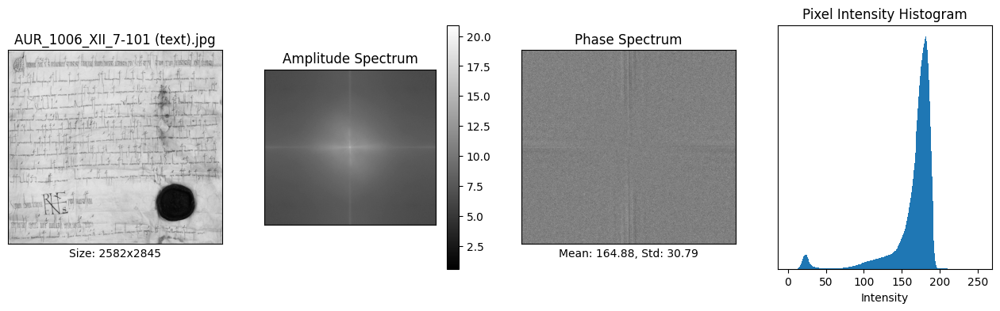

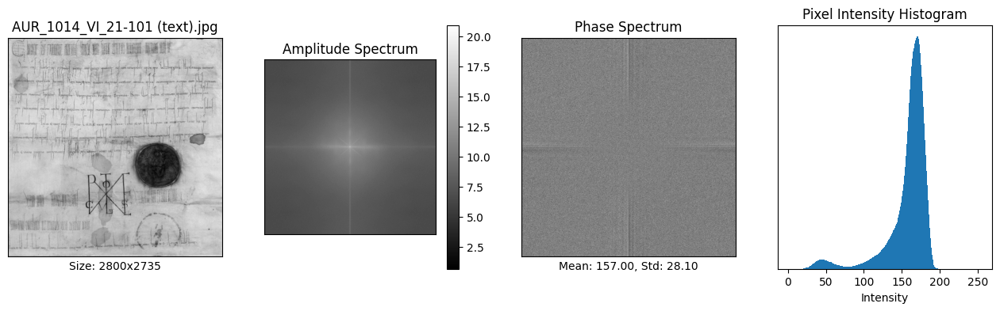

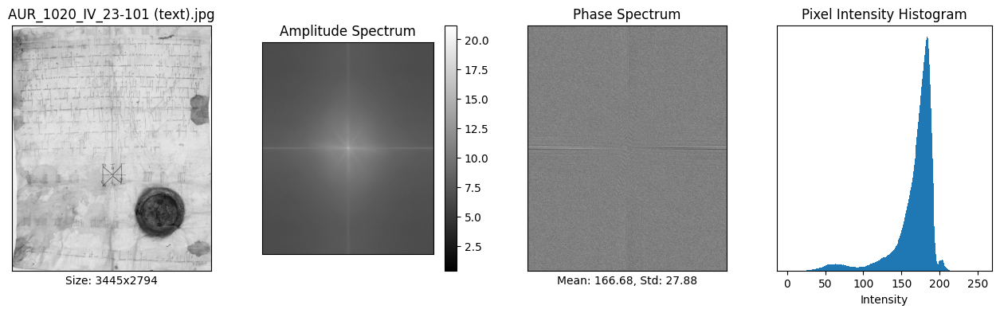

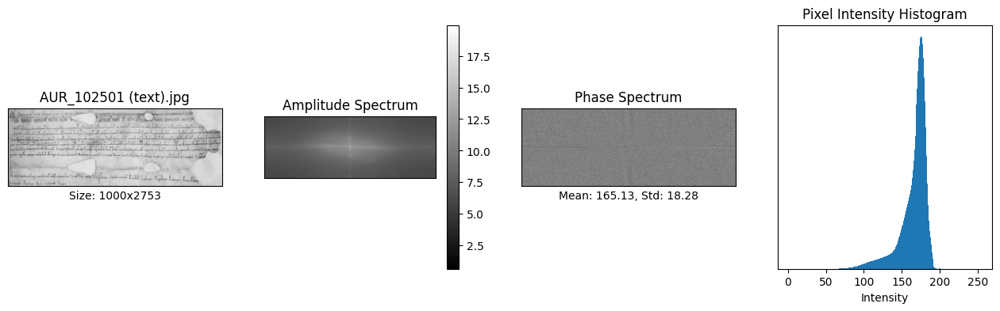

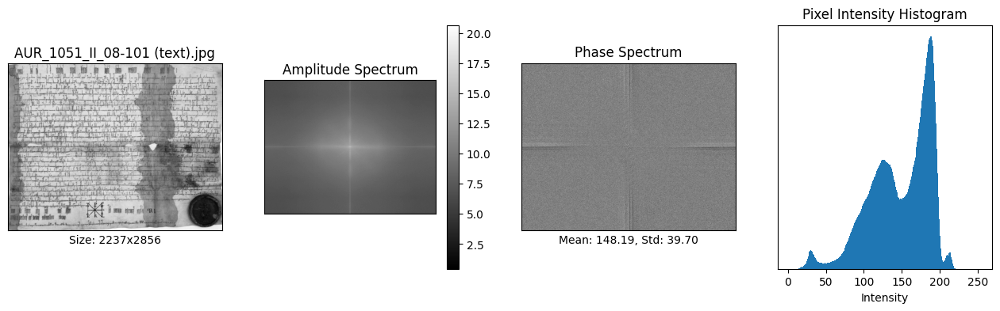

...

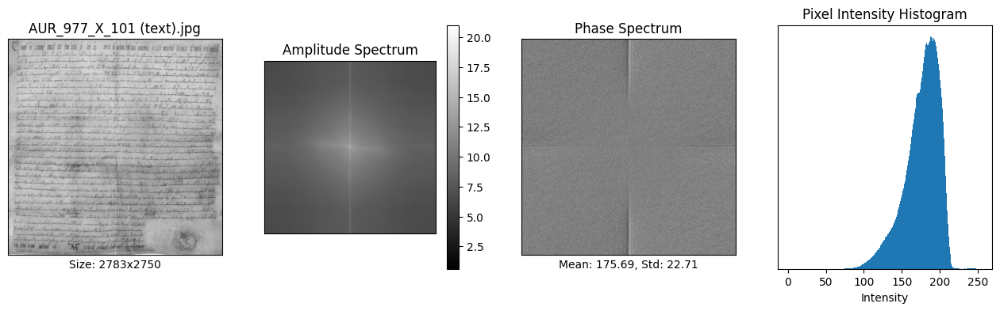

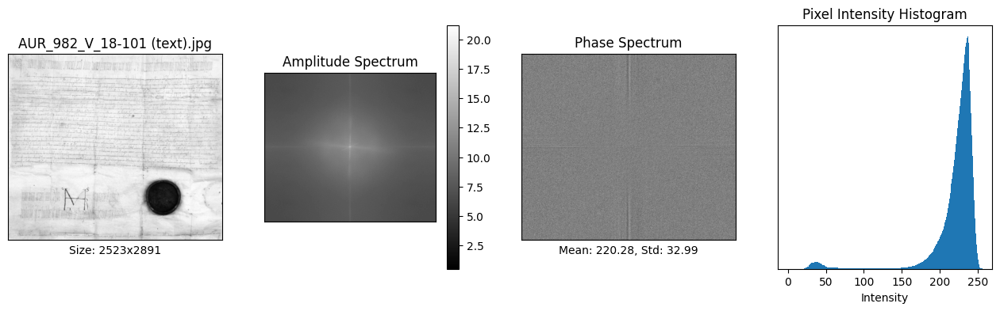

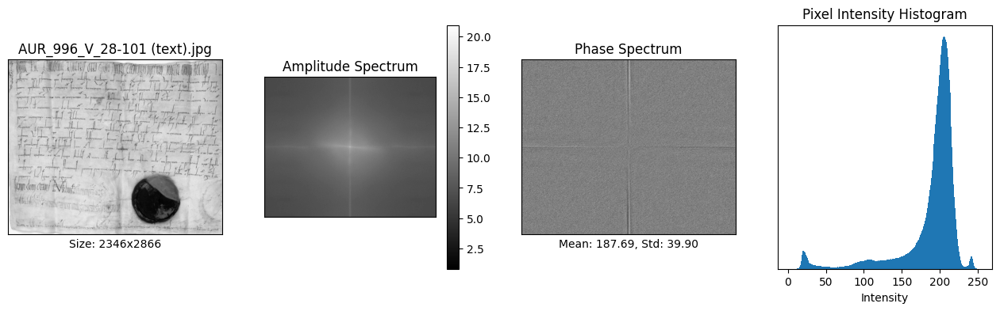

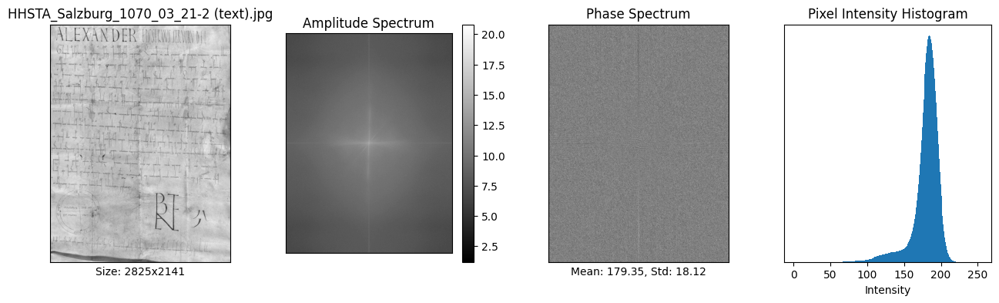

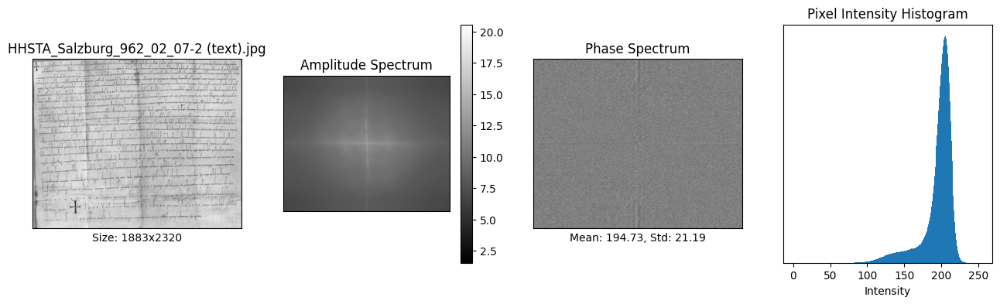

In [3]:
jpg_files = os.listdir(folder_path)
for file_name in jpg_files:
    image_path = os.path.join(folder_path, file_name)
    if os.path.isfile(image_path):
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        fourier_transform = np.fft.fft2(image)
        fourier_transform_shifted = np.fft.fftshift(fourier_transform)
        magnitude_spectrum = np.log(np.abs(fourier_transform_shifted) + 1)

        mean_intensity = np.mean(image)
        std_intensity = np.std(image)

        plt.figure(figsize=(16, 4))

        plt.subplot(1, 4, 1)
        plt.imshow(image, cmap='gray')
        plt.title('{}'.format(file_name)), plt.xticks([]), plt.yticks([])
        plt.xlabel(f"Size: {image.shape[0]}x{image.shape[1]}")

        plt.subplot(1, 4, 2)
        plt.imshow(magnitude_spectrum, cmap='gray')
        plt.title('Amplitude Spectrum'), plt.xticks([]), plt.yticks([])
        plt.colorbar()

        plt.subplot(1, 4, 4)
        plt.hist(image.ravel(), bins=256, range=(0, 256))
        plt.title('Pixel Intensity Histogram'), plt.yticks([])
        plt.xlabel('Intensity')
        
        plt.subplot(1, 4, 3)
        plt.imshow(np.angle(fourier_transform_shifted), cmap='gray')
        plt.title('Phase Spectrum'), plt.xticks([]), plt.yticks([])
        plt.xlabel('Mean: {:.2f}, Std: {:.2f}'.format( mean_intensity, std_intensity))

        plt.show()

Visual display of images after processing

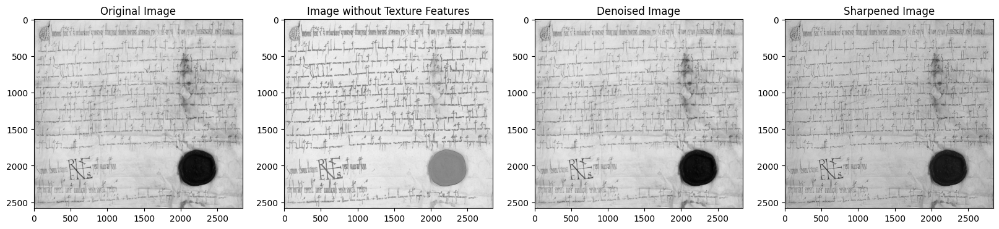

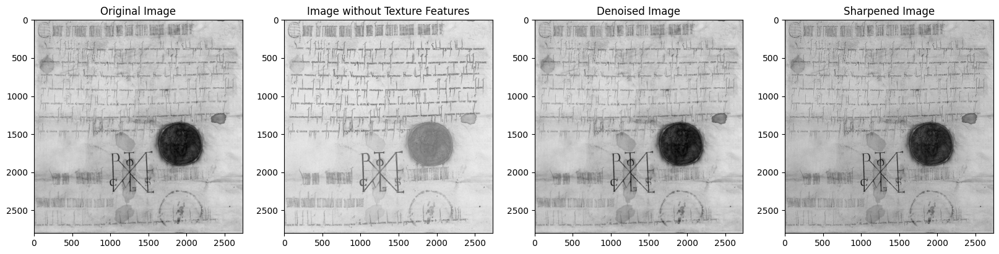

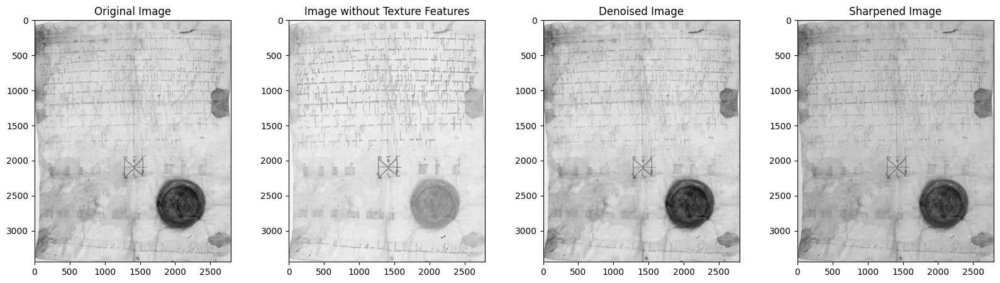

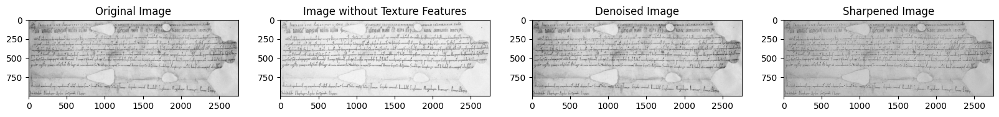

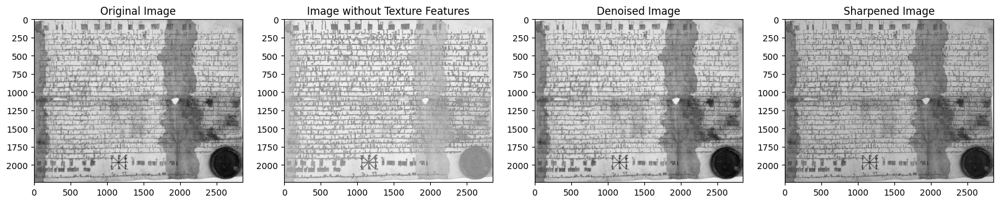

...

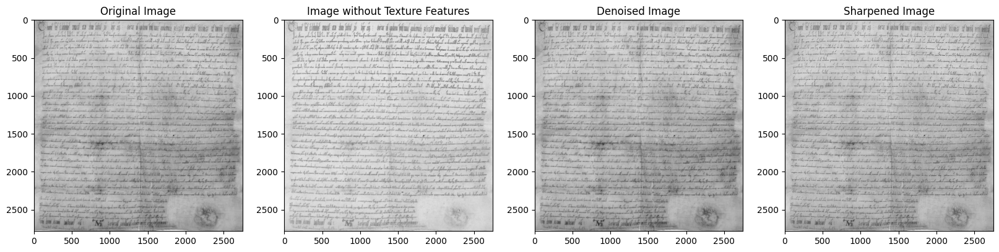

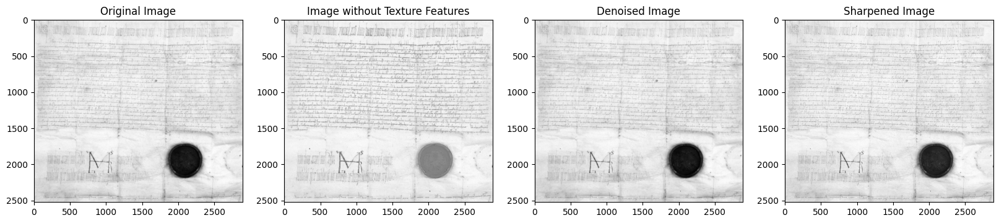

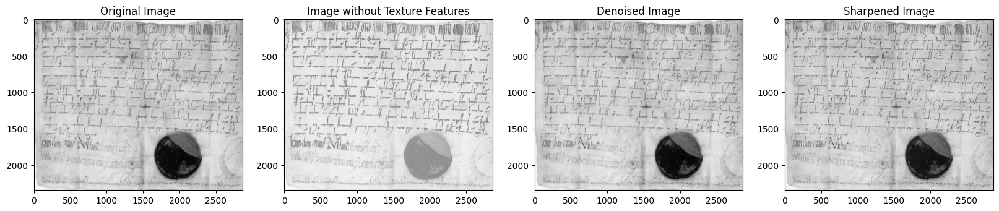

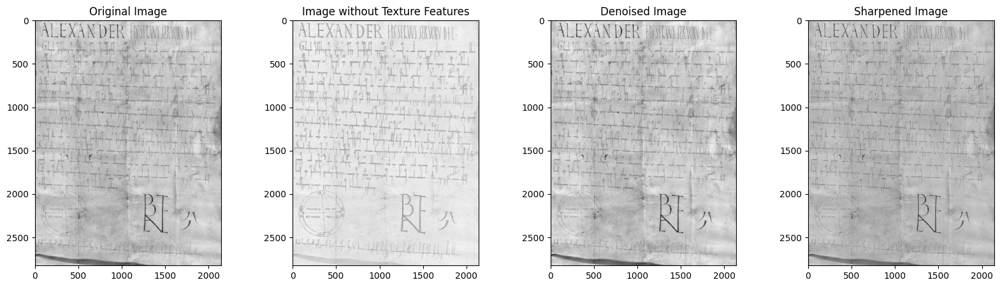

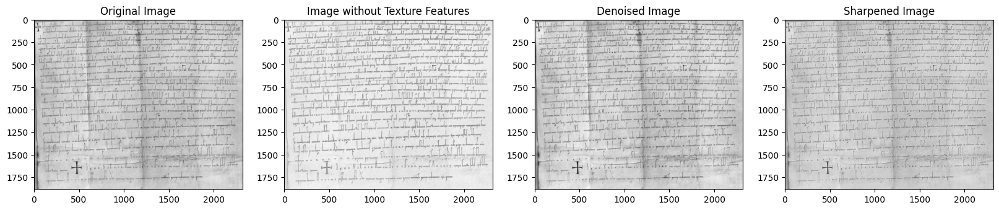

In [4]:
original_images_folder = "original_images"
texture_images_folder = "texture_images"

if not os.path.exists(texture_images_folder):
    os.makedirs(texture_images_folder)
if not os.path.exists(original_images_folder):
    os.makedirs(original_images_folder)

def extract_features(image):
    sobelx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    sobely = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
    features = np.sqrt(sobelx**2 + sobely**2)

    return features

for jpg_file in jpg_files:
    image_path = os.path.join(folder_path, jpg_file)
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    features = extract_features(image)
    denoised_image = median(image)
    
    sharp_image = unsharp_mask(denoised_image, radius=2, amount=2)
    cv2.imwrite(os.path.join(texture_images_folder, jpg_file), sharp_image)
    plt.figure(figsize=(20, 5))
    plt.subplot(1, 4, 1)
    plt.imshow(image, cmap='gray')
    plt.title('Original Image')
    
    plt.subplot(1, 4, 2)
    plt.imshow(image - features, cmap='gray')
    plt.title('Image without Texture Features')
    
    plt.subplot(1, 4, 3)
    plt.imshow(denoised_image, cmap='gray')
    plt.title('Denoised Image')
    
    plt.subplot(1, 4, 4)
    plt.imshow(sharp_image, cmap='gray')
    plt.title('Sharpened Image')
    
    plt.show()